# Unit 5 - Financial Planning


In [8]:
# Initial imports
import os
import requests
import pandas as pd
from dotenv import load_dotenv
import alpaca_trade_api as tradeapi
from MCForecastTools import MCSimulation
from pprint import pprint

%matplotlib inline

In [2]:
# Load .env enviroment variables
load_dotenv()

True

## Part 1 - Personal Finance Planner

### Collect Crypto Prices Using the `requests` Library

In [12]:
# Set current amount of crypto assets
my_btc = 1.2
my_eth = 5.3

In [4]:
# Crypto API URLs
btc_url = "https://api.alternative.me/v2/ticker/Bitcoin/?convert=CAD"
eth_url = "https://api.alternative.me/v2/ticker/Ethereum/?convert=CAD"

In [13]:
# Fetch current BTC price
btc_data = requests.get(btc_url).json()
# pprint(btc_data)

# Fetch current ETH price
eth_data = requests.get(eth_url).json()
# pprint(eth_data)
# Compute current value of my crpto
current_btc_price= btc_data['data']['1']['quotes']['USD']['price']
current_etc_price= eth_data['data']['1027']['quotes']['USD']['price']
# Print current crypto wallet balance
print(f"The current value of your {my_btc} BTC is ${current_btc_price:0.2f}")
print(f"The current value of your {my_eth} ETH is ${current_etc_price:0.2f}")

The current value of your 1.2 BTC is $11351.35
The current value of your 5.3 ETH is $367.21


### Collect Investments Data Using Alpaca: `SPY` (stocks) and `AGG` (bonds)

In [23]:
# Current amount of shares
my_agg = 200
my_spy = 50

In [14]:
# Set Alpaca API key and secret
alpaca_api_key = os.getenv("ALPACA_API_KEY")
alpaca_secret_key = os.getenv("ALPACA_SECRET_KEY")

# Create the Alpaca API object
api = tradeapi.REST(
    alpaca_api_key,
    alpaca_secret_key,
    api_version= 'v2'
)

In [19]:
# Format current date as ISO format
today = pd.Timestamp("2020-10-16", tz="America/New_York").isoformat()

# Set the tickers
tickers = ["AGG", "SPY"]

# Set timeframe to '1D' for Alpaca API
timeframe = "1D"

# Get current closing prices for SPY and AGG
df_investments = api.get_barset(
    tickers,
    timeframe,
    start = today,
    end = today
).df

# Preview DataFrame
df_investments.head()

AGG                                        SPY  \
                             open      high     low   close   volume    open   
2020-10-16 00:00:00-04:00  117.99  118.0778  117.88  117.88  3589312  348.96   

                                                            
                             high    low   close    volume  
2020-10-16 00:00:00-04:00  350.75  347.1  347.25  62467863

In [21]:
# Pick AGG and SPY close prices
agg_close_price = float(df_investments['AGG']['close'])
spy_close_price = float(df_investments['SPY']['close'])

# Print AGG and SPY close prices
print(f"Current AGG closing price: ${agg_close_price}")
print(f"Current SPY closing price: ${spy_close_price}")

Current AGG closing price: $117.88
Current SPY closing price: $347.25


In [24]:
# Compute the current value of shares
my_spy_value = my_spy * spy_close_price
my_agg_value = my_agg * agg_close_price

# Print current value of share
print(f"The current value of your {my_spy} SPY shares is ${my_spy_value:0.2f}")
print(f"The current value of your {my_agg} AGG shares is ${my_agg_value:0.2f}")

The current value of your 50 SPY shares is $17362.50
The current value of your 200 AGG shares is $23576.00


### Savings Health Analysis

In [38]:
# Set monthly household income
monthly_income = 12000

# Create savings DataFrame
data = {
    'amount': [(current_btc_price+current_etc_price),(my_agg_value + my_spy_value)],

}
df_savings = pd.DataFrame(data, index=['crypto', 'shares'])
# df_savings.index.name = ["crypto", "shares"]

# Display savings DataFrame
display(df_savings)

,amount
crypto,11718.56
shares,40938.50


In [66]:
df_savings.iloc[1]

amount    40938.5
Name: shares, dtype: float64

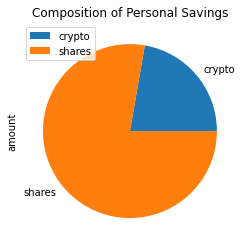

In [39]:
# Plot savings pie chart
df_savings.plot.pie(y='amount', title= 'Composition of Personal Savings')

In [80]:
# Set ideal emergency fund
emergency_fund = monthly_income * 100

# Calculate total amount of savings
total_savings = float(df_savings.iloc[0] + df_savings.iloc[1]) 


# Use if conditional statements to validate if the current savings are enough for an emergency fund. An ideal emergency fund should be equal to three times your monthly income.
if total_savings > emergency_fund:
    print("Congratulations!  You have enough money in your emergency fund.")
elif total_savings == emergency_fund:
    print("Congratulations!  You have reached your financial goal.")
else:
    print(f"You haven't reached your goal yet!  Keep working you need ${emergency_fund - total_savings} to reach your goal.")

# If total savings are greater than the emergency fund, display a message congratulating the person for having enough money in this fund.


# If total savings are equal to the emergency fund, display a message congratulating the person on reaching this financial goal.


# If total savings are less than the emergency fund, display a message showing how many dollars away the person is from reaching the goal.
# Validate saving health


You haven't reached your goal yet!  Keep working you need $1147342.94 to reach your goal.


## Part 2 - Retirement Planning

### Monte Carlo Simulation

In [40]:
# Set start and end dates of five years back from today.
# Sample results may vary from the solution based on the time frame chosen
start_date = pd.Timestamp('2015-10-17', tz='America/New_York').isoformat()
end_date = pd.Timestamp('2020-10-17', tz='America/New_York').isoformat()

In [41]:
# Get 5 years' worth of historical data for SPY and AGG
df_stock_data = api.get_barset(
    tickers,
    timeframe,
    start = start_date,
    end = today
).df


# Display sample data
df_stock_data.head()

AGG                                         SPY  \
                             open     high     low   close     volume    open   
2015-10-19 00:00:00-04:00  109.78  109.895  109.65  109.85  1289942.0  202.50   
2015-10-20 00:00:00-04:00  109.64  109.780  109.55  109.65  1672562.0  202.85   
2015-10-21 00:00:00-04:00  109.73  109.950  109.73  109.89  1119723.0  203.61   
2015-10-22 00:00:00-04:00  109.90  110.050  109.83  109.94  1817244.0  202.98   
2015-10-23 00:00:00-04:00  109.79  109.790  109.69  109.74  1344632.0  207.25   

                                                                
                             high       low   close     volume  
2015-10-19 00:00:00-04:00  203.37  202.1300  203.33   61255929  
2015-10-20 00:00:00-04:00  203.84  202.5471  203.07   60081395  
2015-10-21 00:00:00-04:00  203.79  201.6500  201.82   83704739  
2015-10-22 00:00:00-04:00  205.51  202.8100  205.22  121670959  
2015-10-23 00:00:00-04:00  207.95  206.3000  207.51  103135843

In [42]:
# Configuring a Monte Carlo simulation to forecast 30 years cumulative returns
MC_shares = MCSimulation(
    portfolio_data = df_stock_data,
    num_simulation = 500,
    num_trading_days = 252*30
)

In [43]:
# Printing the simulation input data
MC_shares.portfolio_data

AGG                                         \
                             open      high       low   close     volume   
2015-10-19 00:00:00-04:00  109.78  109.8950  109.6500  109.85  1289942.0   
2015-10-20 00:00:00-04:00  109.64  109.7800  109.5500  109.65  1672562.0   
2015-10-21 00:00:00-04:00  109.73  109.9500  109.7300  109.89  1119723.0   
2015-10-22 00:00:00-04:00  109.90  110.0500  109.8300  109.94  1817244.0   
2015-10-23 00:00:00-04:00  109.79  109.7900  109.6900  109.74  1344632.0   
...                           ...       ...       ...     ...        ...   
2020-10-12 00:00:00-04:00  117.85  117.9400  117.7700  117.93  2770157.0   
2020-10-13 00:00:00-04:00  118.01  118.0700  117.9294  118.01  3250338.0   
2020-10-14 00:00:00-04:00  118.10  118.1100  117.9850  118.04  3295967.0   
2020-10-15 00:00:00-04:00  118.15  118.1500  117.9600  117.97  4988612.0   
2020-10-16 00:00:00-04:00  117.99  118.0778  117.8800  117.88  3589312.0   

                                           SPY                              \
                          daily_return    open      high       low   close   
2015-10-19 00:00:00-04:00          NaN  202.50  203.3700  202.1300  203.33   
2015-10-20 00:00:00-04:00    -0.001821  202.85  203.8400  202.5471  203.07   
2015-10-21 00:00:00-04:00     0.002189  203.61  203.7900  201.6500  201.82   
2015-10-22 00:00:00-04:00     0.000455  202.98  205.5100  202.8100  205.22   
2015-10-23 00:00:00-04:00    -0.001819  207.25  207.9500  206.3000  207.51   
...                                ...     ...       ...       ...     ...   
2020-10-12 00:00:00-04:00     0.001912  349.59  354.0200  349.0600  352.43   
2020-10-13 00:00:00-04:00     0.000678  352.28  352.4651  349.0900  350.15   
2020-10-14 00:00:00-04:00     0.000254  350.75  351.9300  347.1400  347.97   
2020-10-15 00:00:00-04:00    -0.000593  343.71  348.0200  343.1300  347.51   
2020-10-16 00:00:00-04:00    -0.000763  348.96  350.7500  347.1000  347.25   

                                                   
                              volume daily_return  
2015-10-19 00:00:00-04:00   61255929          NaN  
2015-10-20 00:00:00-04:00   60081395    -0.001279  
2015-10-21 00:00:00-04:00   83704739    -0.006156  
2015-10-22 00:00:00-04:00  121670959     0.016847  
2015-10-23 00:00:00-04:00  103135843     0.011159  
...                              ...          ...  
2020-10-12 00:00:00-04:00   61163344     0.016117  
2020-10-13 00:00:00-04:00   62272512    -0.006469  
2020-10-14 00:00:00-04:00   47281475    -0.006226  
2020-10-15 00:00:00-04:00   50665477    -0.001322  
2020-10-16 00:00:00-04:00   62467863    -0.000748  

[1259 rows x 12 columns]

In [44]:
# Running a Monte Carlo simulation to forecast 30 years cumulative returns
MC_shares.calc_cumulative_return()

Running Monte Carlo simulation number 0.
Running Monte Carlo simulation number 10.
Running Monte Carlo simulation number 20.
Running Monte Carlo simulation number 30.
Running Monte Carlo simulation number 40.
Running Monte Carlo simulation number 50.
Running Monte Carlo simulation number 60.
Running Monte Carlo simulation number 70.
Running Monte Carlo simulation number 80.
Running Monte Carlo simulation number 90.
Running Monte Carlo simulation number 100.
Running Monte Carlo simulation number 110.
Running Monte Carlo simulation number 120.
Running Monte Carlo simulation number 130.
Running Monte Carlo simulation number 140.
Running Monte Carlo simulation number 150.
Running Monte Carlo simulation number 160.
Running Monte Carlo simulation number 170.
Running Monte Carlo simulation number 180.
Running Monte Carlo simulation number 190.
Running Monte Carlo simulation number 200.
Running Monte Carlo simulation number 210.
Running Monte Carlo simulation number 220.
Running Monte Carlo si

,0,1,2,3,4,5,6,7,8,9,...,490,491,492,493,494,495,496,497,498,499
0,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
1,1.002017,0.999803,0.989381,0.997459,0.993799,0.999920,1.003515,1.004150,1.006693,1.001918,...,1.000631,0.995969,1.002756,1.006024,1.004681,1.007722,0.997200,1.000536,1.001360,0.999304
2,1.005782,1.002745,0.979245,0.993399,0.988021,0.997645,0.996097,0.998405,1.003065,0.994898,...,0.997614,1.003796,1.005729,1.007737,1.004264,1.010760,0.995602,1.007244,1.002322,1.001635
3,1.015673,0.999504,0.980359,0.997747,0.986109,0.993332,0.997034,0.991729,1.008612,0.990384,...,0.992543,1.007486,1.009934,1.019483,1.002200,1.008500,0.993690,1.005975,1.000394,0.998362
4,1.018374,0.998835,0.985344,1.011704,0.984186,0.996501,0.989347,0.991974,1.020336,0.984870,...,0.993819,1.021815,1.022467,1.018153,1.005741,1.008505,0.992226,1.006538,0.993509,0.997710
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7556,10.884186,4.628852,4.150430,7.584938,4.313576,9.968040,7.538008,11.568865,17.521490,5.755455,...,8.810881,15.061336,1.496777,25.459686,4.588384,7.518824,16.203597,2.809149,4.896186,3.146614
7557,10.959025,4.645176,4.108005,7.573618,4.326791,9.865198,7.538385,11.605173,17.646160,5.780236,...,8.849650,14.805423,1.494704,25.517105,4.563930,7.440661,16.190924,2.807651,4.911837,3.158382
7558,10.864407,4.589327,4.136305,7.546424,4.316881,9.853758,7.587604,11.665811,17.721543,5.751782,...,8.775597,15.027168,1.511120,25.594008,4.606716,7.491067,16.100481,2.801559,4.929408,3.168537
7559,10.922619,4.596607,4.142789,7.537197,4.313635,9.798672,7.614990,11.720600,17.659925,5.778056,...,8.755692,15.102285,1.515465,25.628457,4.616626,7.488452,15.853138,2.803209,4.898881,3.175598


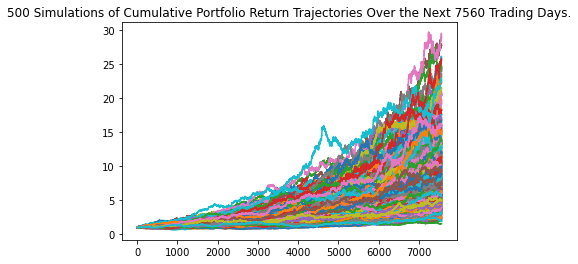

In [45]:
# Plot simulation outcomes
MC_shares.plot_simulation()

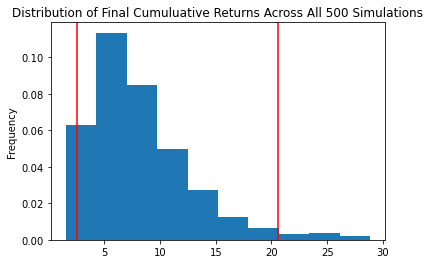

In [46]:
# Plot probability distribution and confidence intervals
MC_shares.plot_distribution()

### Retirement Analysis

In [47]:
# Fetch summary statistics from the Monte Carlo simulation results
shares_tbl = MC_shares.summarize_cumulative_return()

# Print summary statistics
shares_tbl

count           500.000000
mean              8.233261
std               4.583971
min               1.532166
25%               5.020189
50%               7.200352
75%              10.248839
max              28.859884
95% CI Lower      2.537451
95% CI Upper     20.605719
Name: 7560, dtype: float64

### Calculate the expected portfolio return at the 95% lower and upper confidence intervals based on a `$20,000` initial investment.

In [48]:
# Set initial investment
initial_investment = 20000

# Use the lower and upper `95%` confidence intervals to calculate the range of the possible outcomes of our $20,000
ci_lower = round(shares_tbl[8]*initial_investment,2)
ci_upper = round(shares_tbl[9]*initial_investment,2)

# Print results
print(f"There is a 95% chance that an initial investment of ${initial_investment} in the portfolio"
      f" over the next 30 years will end within in the range of"
      f" ${ci_lower} and ${ci_upper}")

There is a 95% chance that an initial investment of $20000 in the portfolio over the next 30 years will end within in the range of $50749.02 and $412114.39


### Calculate the expected portfolio return at the `95%` lower and upper confidence intervals based on a `50%` increase in the initial investment.

In [49]:
# Set initial investment
initial_investment = 20000 * 1.5

# Use the lower and upper `95%` confidence intervals to calculate the range of the possible outcomes of our $30,000
ci_lower = round(shares_tbl[8]*initial_investment,2)
ci_upper = round(shares_tbl[9]*initial_investment,2)

# Print results
print(f"There is a 95% chance that an initial investment of ${initial_investment} in the portfolio"
      f" over the next 30 years will end within in the range of"
      f" ${ci_lower} and ${ci_upper}")

There is a 95% chance that an initial investment of $30000.0 in the portfolio over the next 30 years will end within in the range of $76123.53 and $618171.58


## Optional Challenge - Early Retirement


### Five Years Retirement Option

In [51]:
# Configuring a Monte Carlo simulation to forecast 5 years cumulative returns
MC_5yr = MCSimulation(
    portfolio_data = df_stock_data,
    num_simulation = 500,
    num_trading_days = 252*5
)
MC_5yr.portfolio_data

AGG                                         \
                             open      high       low   close     volume   
2015-10-19 00:00:00-04:00  109.78  109.8950  109.6500  109.85  1289942.0   
2015-10-20 00:00:00-04:00  109.64  109.7800  109.5500  109.65  1672562.0   
2015-10-21 00:00:00-04:00  109.73  109.9500  109.7300  109.89  1119723.0   
2015-10-22 00:00:00-04:00  109.90  110.0500  109.8300  109.94  1817244.0   
2015-10-23 00:00:00-04:00  109.79  109.7900  109.6900  109.74  1344632.0   
...                           ...       ...       ...     ...        ...   
2020-10-12 00:00:00-04:00  117.85  117.9400  117.7700  117.93  2770157.0   
2020-10-13 00:00:00-04:00  118.01  118.0700  117.9294  118.01  3250338.0   
2020-10-14 00:00:00-04:00  118.10  118.1100  117.9850  118.04  3295967.0   
2020-10-15 00:00:00-04:00  118.15  118.1500  117.9600  117.97  4988612.0   
2020-10-16 00:00:00-04:00  117.99  118.0778  117.8800  117.88  3589312.0   

                                           SPY                              \
                          daily_return    open      high       low   close   
2015-10-19 00:00:00-04:00          NaN  202.50  203.3700  202.1300  203.33   
2015-10-20 00:00:00-04:00    -0.001821  202.85  203.8400  202.5471  203.07   
2015-10-21 00:00:00-04:00     0.002189  203.61  203.7900  201.6500  201.82   
2015-10-22 00:00:00-04:00     0.000455  202.98  205.5100  202.8100  205.22   
2015-10-23 00:00:00-04:00    -0.001819  207.25  207.9500  206.3000  207.51   
...                                ...     ...       ...       ...     ...   
2020-10-12 00:00:00-04:00     0.001912  349.59  354.0200  349.0600  352.43   
2020-10-13 00:00:00-04:00     0.000678  352.28  352.4651  349.0900  350.15   
2020-10-14 00:00:00-04:00     0.000254  350.75  351.9300  347.1400  347.97   
2020-10-15 00:00:00-04:00    -0.000593  343.71  348.0200  343.1300  347.51   
2020-10-16 00:00:00-04:00    -0.000763  348.96  350.7500  347.1000  347.25   

                                                   
                              volume daily_return  
2015-10-19 00:00:00-04:00   61255929          NaN  
2015-10-20 00:00:00-04:00   60081395    -0.001279  
2015-10-21 00:00:00-04:00   83704739    -0.006156  
2015-10-22 00:00:00-04:00  121670959     0.016847  
2015-10-23 00:00:00-04:00  103135843     0.011159  
...                              ...          ...  
2020-10-12 00:00:00-04:00   61163344     0.016117  
2020-10-13 00:00:00-04:00   62272512    -0.006469  
2020-10-14 00:00:00-04:00   47281475    -0.006226  
2020-10-15 00:00:00-04:00   50665477    -0.001322  
2020-10-16 00:00:00-04:00   62467863    -0.000748  

[1259 rows x 12 columns]

In [52]:
# Running a Monte Carlo simulation to forecast 5 years cumulative returns
MC_5yr.calc_cumulative_return()

Running Monte Carlo simulation number 0.
Running Monte Carlo simulation number 10.
Running Monte Carlo simulation number 20.
Running Monte Carlo simulation number 30.
Running Monte Carlo simulation number 40.
Running Monte Carlo simulation number 50.
Running Monte Carlo simulation number 60.
Running Monte Carlo simulation number 70.
Running Monte Carlo simulation number 80.
Running Monte Carlo simulation number 90.
Running Monte Carlo simulation number 100.
Running Monte Carlo simulation number 110.
Running Monte Carlo simulation number 120.
Running Monte Carlo simulation number 130.
Running Monte Carlo simulation number 140.
Running Monte Carlo simulation number 150.
Running Monte Carlo simulation number 160.
Running Monte Carlo simulation number 170.
Running Monte Carlo simulation number 180.
Running Monte Carlo simulation number 190.
Running Monte Carlo simulation number 200.
Running Monte Carlo simulation number 210.
Running Monte Carlo simulation number 220.
Running Monte Carlo si

,0,1,2,3,4,5,6,7,8,9,...,490,491,492,493,494,495,496,497,498,499
0,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
1,1.003798,1.003644,0.999708,0.991571,1.004395,1.011140,0.994777,0.994165,1.007138,0.996445,...,1.008602,1.006044,0.998949,1.000289,1.008060,0.992037,1.002289,1.000318,1.011663,0.996444
2,1.009113,0.993454,0.996785,1.002479,1.001680,1.014080,0.986929,1.001540,1.013105,0.995908,...,0.997081,1.001201,1.004827,1.005492,1.007794,0.987928,1.003355,1.001626,1.005154,1.001684
3,1.010882,0.989816,0.994798,1.004291,0.999819,1.035788,0.991862,0.994367,1.008932,0.996981,...,0.998137,1.001845,1.018622,0.993525,1.014011,0.986427,1.005046,0.990148,1.006487,0.998644
4,1.008842,0.990044,1.002006,1.002257,1.003338,1.041192,0.994541,0.997745,1.014804,0.993867,...,0.997096,1.006011,1.010218,0.985433,1.021336,0.979810,1.006961,0.982500,1.008495,0.984559
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1256,2.143559,1.777569,2.071403,1.476203,1.881009,2.108878,1.614360,2.271118,1.455225,1.358236,...,1.606022,1.754182,1.750358,1.476237,1.466628,1.111122,1.203680,1.355562,1.721836,1.011366
1257,2.143611,1.775088,2.091669,1.481211,1.875002,2.106814,1.613993,2.273942,1.463568,1.366711,...,1.603515,1.747679,1.767860,1.480113,1.455824,1.109572,1.224523,1.355890,1.713493,1.013436
1258,2.131509,1.786808,2.077158,1.487173,1.868384,2.103841,1.611336,2.288217,1.468006,1.357617,...,1.605688,1.747186,1.782404,1.485566,1.451332,1.107607,1.228155,1.352873,1.710213,1.015976
1259,2.151402,1.805288,2.103930,1.500725,1.853453,2.102470,1.611630,2.288078,1.468512,1.354575,...,1.618314,1.760280,1.780571,1.481271,1.444881,1.122286,1.231571,1.349033,1.719475,1.016981


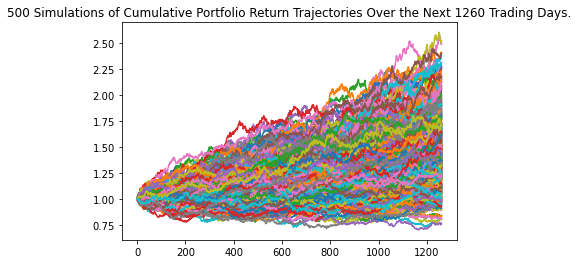

In [53]:
# Plot simulation outcomes
MC_5yr.plot_simulation()

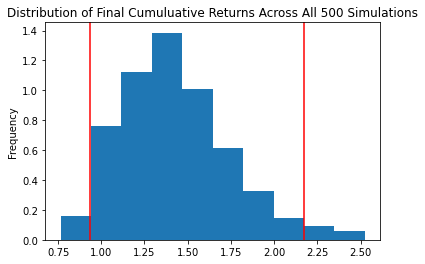

In [55]:
# Plot probability distribution and confidence intervals
MC_5yr.plot_distribution()

In [56]:
# Fetch summary statistics from the Monte Carlo simulation results
fiveyr_tbl = MC_5yr.summarize_cumulative_return()

# Print summary statistics
fiveyr_tbl

count           500.000000
mean              1.428803
std               0.315397
min               0.764184
25%               1.210029
50%               1.398362
75%               1.621605
max               2.524971
95% CI Lower      0.936402
95% CI Upper      2.175004
Name: 1260, dtype: float64

In [57]:
# Set initial investment
initial_investment = 60000

# Use the lower and upper `95%` confidence intervals to calculate the range of the possible outcomes of our $60,000
ci_lower_five = round(fiveyr_tbl[8]*initial_investment,2)
ci_upper_five = round(fiveyr_tbl[9]*initial_investment,2)

# Print results
print(f"There is a 95% chance that an initial investment of ${initial_investment} in the portfolio"
      f" over the next 5 years will end within in the range of"
      f" ${ci_lower_five} and ${ci_upper_five}")

There is a 95% chance that an initial investment of $60000 in the portfolio over the next 5 years will end within in the range of $56184.11 and $130500.22


### Ten Years Retirement Option

In [81]:
# This is commented out downsize the file and to be able to view notebook on github
# # Configuring a Monte Carlo simulation to forecast 10 years cumulative returns
# MC_10yr = MCSimulation(
#     portfolio_data = df_stock_data,
#     num_simulation = 500,
#     num_trading_days = 252*10
# )


In [82]:
# Running a Monte Carlo simulation to forecast 10 years cumulative returns
# MC_10yr.calc_cumulative_return()

In [83]:
# # Plot simulation outcomes
# MC_10yr.plot_simulation()

In [84]:
# # Plot probability distribution and confidence intervals
# MC_10yr.plot_distribution()

In [85]:
# # Fetch summary statistics from the Monte Carlo simulation results
# ten_yr_tbl = MC_10yr.summarize_cumulative_return()

# # Print summary statistics
# ten_yr_tbl

In [87]:
# # Set initial investment
# initial_investment = 60000

# # Use the lower and upper `95%` confidence intervals to calculate the range of the possible outcomes of our $60,000
# ci_lower_ten = round(ten_yr_tbl[8]*initial_investment,2)
# ci_upper_ten = round(ten_yr_tbl[9]*initial_investment,2)

# # Print results
# print(f"There is a 95% chance that an initial investment of ${initial_investment} in the portfolio"
#       f" over the next 10 years will end within in the range of"
#       f" ${ci_lower_ten} and ${ci_upper_ten}")